In [1]:
import sys
print(sys.version) # 3.6.8

3.6.8 (default, Dec 24 2018, 19:24:27) 
[GCC 5.4.0 20160609]


In [2]:
# import tensorflow as tf

# tf.enable_eager_execution()

In [3]:
import matplotlib.pyplot as plt
from matplotlib.colors import DivergingNorm

import numpy as np
import pandas as pd

import h5py

import pickle
import cv2
import os

import PIL
import time
import pathlib

from sklearn.decomposition import PCA, FastICA

from sklearn.linear_model import LinearRegression
from sklearn.metrics import explained_variance_score, r2_score

from pandas.plotting import scatter_matrix

from scipy.stats import gaussian_kde
from scipy.signal import find_peaks

from math import sqrt

from itertools import combinations, combinations_with_replacement

from cycler import cycler


from matplotlib.ticker import NullFormatter
from sklearn.manifold import TSNE

In [4]:
pd.set_option('display.float_format', lambda x: '{:.3f}'.format(x))

df = pd.read_csv('/data/fp_ica.csv')
df = df.set_index('ID')

# display(df[:10])
# display(df.describe().T)

col_factors = ['factor{}'.format(i) for i in range(7)]
col_attributes = ['year',
                  'N_Housings', 'N_Units',
                  'Max_Floors', 'Min_Floors',
                  'Area', 
                  'Rooms', 'Baths']

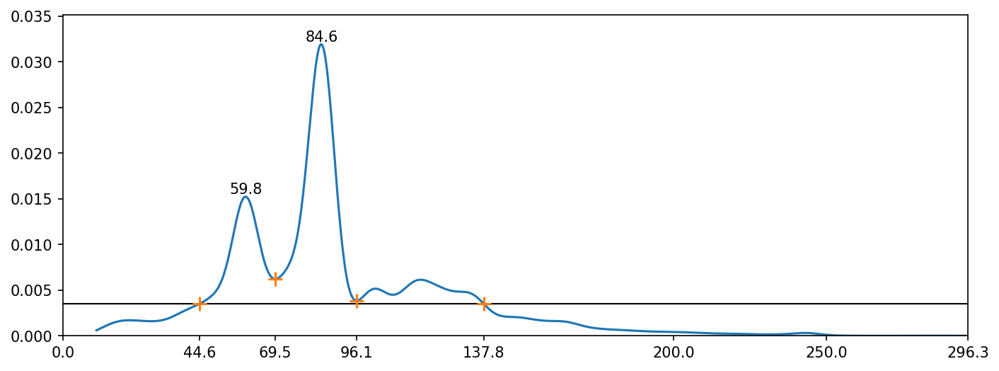

In [5]:
xlim = [df['Area'].min(), df['Area'].max()]
kernel = gaussian_kde(df['Area'])
xs = np.arange(*xlim, (xlim[1]-xlim[0])/1000)
ys = kernel(xs)
cuts, _ = find_peaks(-np.absolute(ys-np.average(ys)),
                      prominence=0.1*np.average(ys),
                      width=20)

peaks, _ = find_peaks(ys, height=2*np.average(ys))

prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

fig = plt.figure(figsize=(11, 4), dpi=300)
ax = fig.gca()
ax.plot(xs, ys, c=colors[0])
ax.axhline(np.average(ys), c='k', lw=1)
ax.scatter(xs[cuts], ys[cuts], c=colors[1], s=100, marker='+', zorder=2.5)

[ax.text(x, y, '{:0.1f}'.format(x), ha='center', va='bottom') for x, y in zip(xs[peaks], ys[peaks])]

ax.set_xticks(np.append(xs[cuts], [0, 200, 250, xs.max()]))
ax.set_xlim(0, xs.max())
ax.set_ylim(0, ys.max()*1.10)
plt.show()

In [6]:
df['group_area'] = pd.cut(df['Area'], xs[cuts], labels=['60m2', '85m2', 'Above'])
# df[col_attributes].groupby(df['group_area']).describe().T

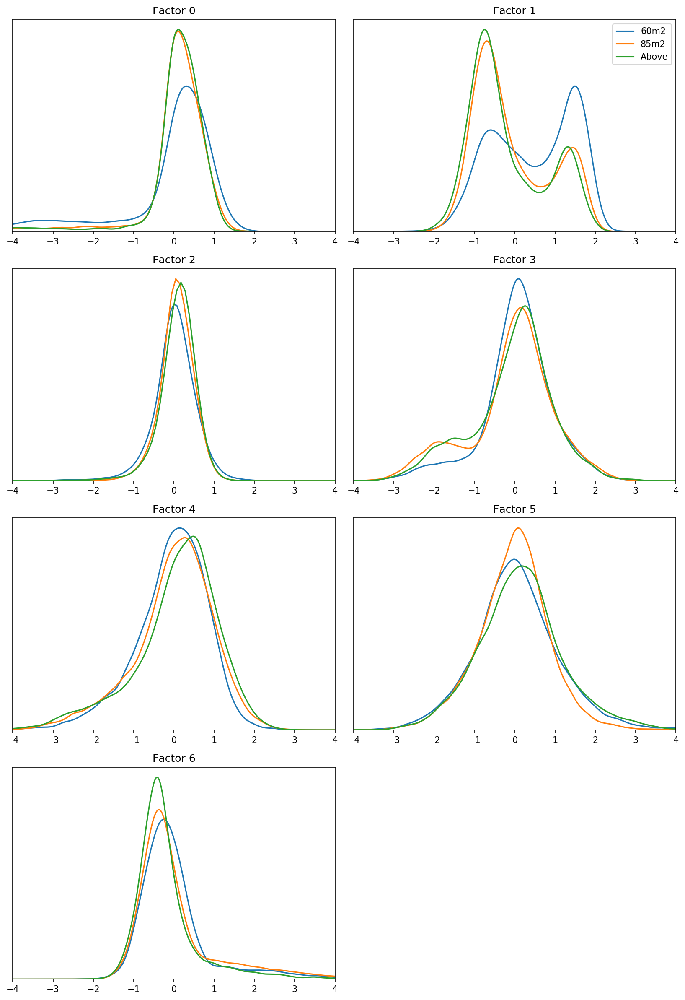

In [7]:
n_cols = 2
if len(col_factors) % n_cols:
    n_rows = len(col_factors)//n_cols + 1
else:
    n_rows = len(col_factors)//n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(11, 16), dpi=300)
axes = axes.flatten()
[axes[i].set_axis_off() for i in range(len(col_factors), len(axes))]
    
for i, f in enumerate(col_factors):
    (df[f]
     .groupby(df['group_area'])
     .plot.kde(xlim=(-4, 4),
               ax=axes[i]))
    axes[i].set_ylim(bottom=0)
    axes[i].set_title('Factor {}'.format(i))

[axes[i].yaxis.set_visible(False) for i in range(len(axes))]
axes[n_cols-1].legend()
# plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.tight_layout()
plt.show()

In [101]:
X = df[col_factors]
perplexities = [2, 5, 30, 50, 100]
ys = []

for i, perplexity in enumerate(perplexities):
    tsne = TSNE(perplexity=perplexity, random_state=1106)
    
    print(f"Run #{i}, perplexity={perplexity} started")
    Y = tsne.fit_transform(X)
    print(f"Run #{i}, perplexity={perplexity} finished")

    ys.append(Y)

Run #0, perplexity=2 started
Run #0, perplexity=2 finished
Run #1, perplexity=5 started
Run #1, perplexity=5 finished
Run #2, perplexity=30 started
Run #2, perplexity=30 finished
Run #3, perplexity=50 started
Run #3, perplexity=50 finished
Run #4, perplexity=100 started
Run #4, perplexity=100 finished


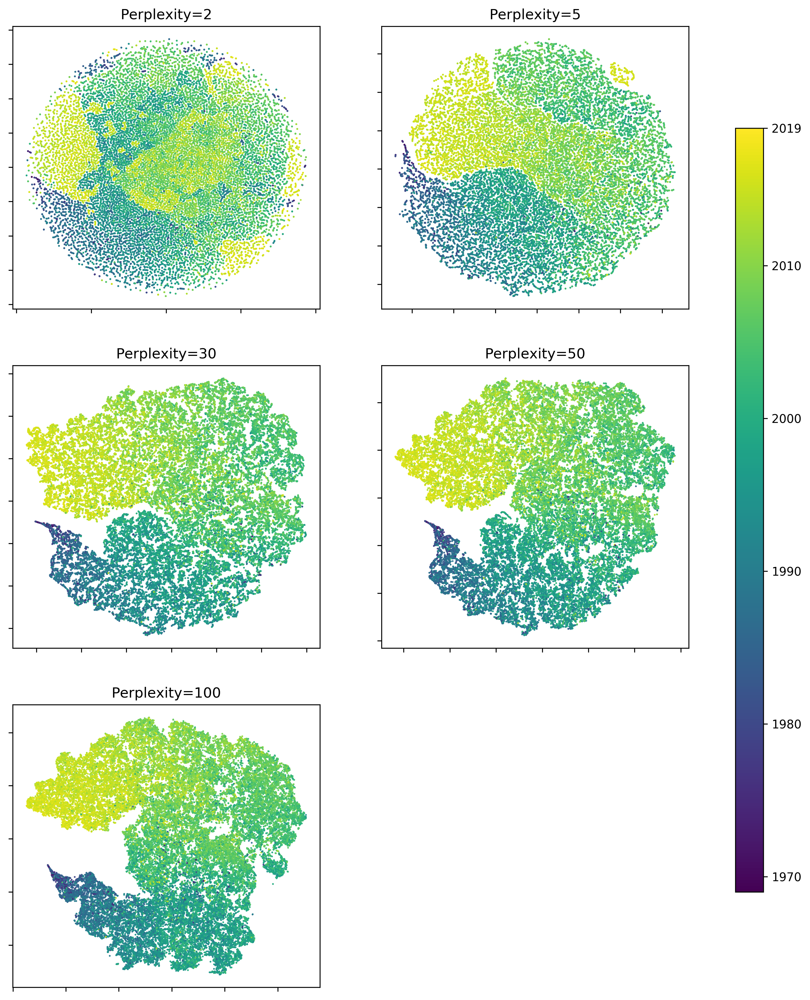

In [125]:
n_cols = 2
if len(perplexities) % n_cols:
    n_rows = len(perplexities)//n_cols + 1
else:
    n_rows = len(perplexities)//n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(11, 15), dpi=300)
axes = axes.flatten()
[axes[i].set_axis_off() for i in range(len(perplexities), len(axes))]

fig.subplots_adjust(right=0.85)

for i, perplexity in enumerate(perplexities):
    Y = ys[i]

    ax = axes[i]
    ax.set_title(f"Perplexity={perplexity}")
    ax.scatter(Y[:, 0], Y[:, 1], c=df['year'], marker='.', s=1)
    ax.xaxis.set_major_formatter(NullFormatter())
    ax.yaxis.set_major_formatter(NullFormatter())
    
    ax.set_aspect('equal')
    ax.axis('tight')
    
cbar_ax = fig.add_axes([0.90, 0.2, 0.03, 0.6])
cbar = fig.colorbar(ax.collections[0], cax=cbar_ax)
cbar.set_ticks(np.append(cbar.get_ticks(), df['year'].max()))

plt.show()
# too big for pdf
fig.savefig("tsne_by_perplexity.png")

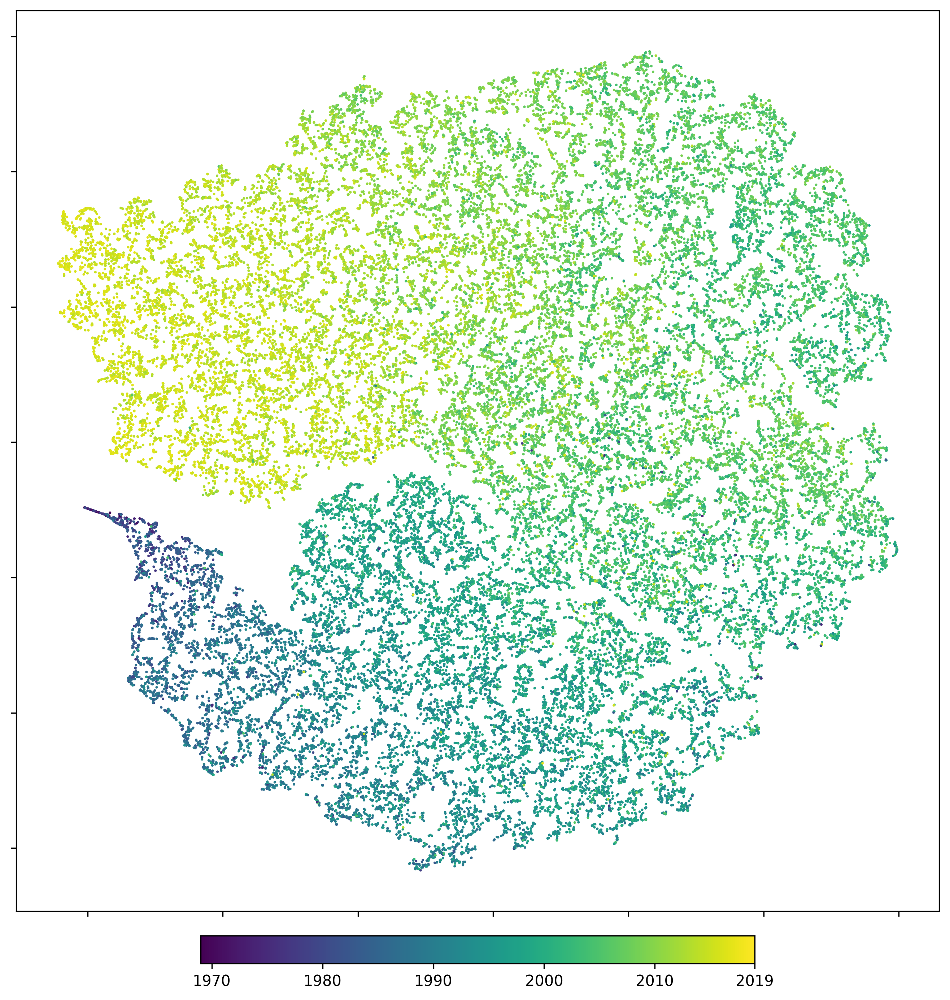

In [126]:
# perplexity 30
Y = ys[2] 

fig = plt.figure(figsize=(11, 15), dpi=300)
ax = fig.gca()
ax.scatter(df['tsne0'], df['tsne1'], c=df['year'], marker='.', s=2)
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())
ax.set_aspect('equal')

cbar = fig.colorbar(ax.collections[0], ax=ax, 
                    orientation="horizontal", shrink=0.6, pad=0.02)
cbar.set_ticks(np.append(cbar.get_ticks(), df['year'].max()))

plt.show()
fig.savefig("tsne_big.png")

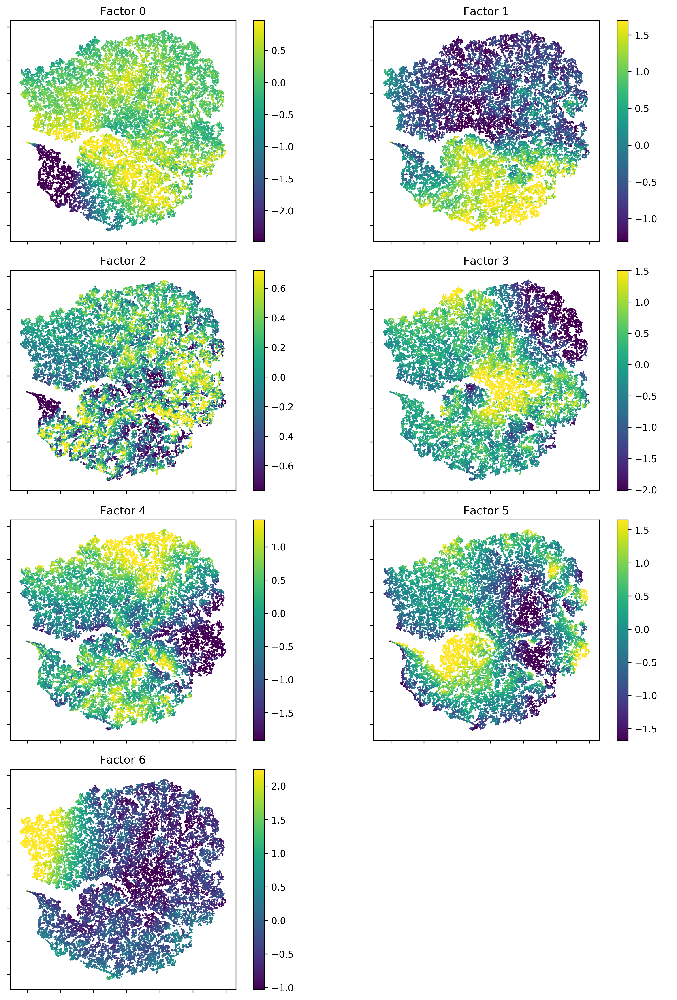

In [129]:
# colored by factors

# perplexity 30
Y = ys[2] 

n_cols = 2
if len(col_factors) % n_cols:
    n_rows = len(col_factors)//n_cols + 1
else:
    n_rows = len(col_factors)//n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(11, 15), dpi=300)
axes = axes.flatten()
[axes[i].set_axis_off() for i in range(len(col_factors), len(axes))]
    
for i, f in enumerate(col_factors):
    ax = axes[i]
    c = df[f]
    vmin, vmax = c.quantile([.05, .95])

    ax.scatter(Y[:, 0], Y[:, 1], c=c, marker='.', s=1,
               vmin=vmin, vmax=vmax)
    
    ax.set_title(f'Factor {i}')
    ax.xaxis.set_major_formatter(NullFormatter())
    ax.yaxis.set_major_formatter(NullFormatter())
    
    cbar = fig.colorbar(ax.collections[0], ax=ax)
#     cbar.set_ticks([-2, -1, 0, 1, 2])
    
    ax.axis('tight')
    ax.set_aspect('equal')

plt.tight_layout()
plt.show()
fig.savefig("tsne_by_factor.png")

In [130]:
# display(df.describe().T)

# perplexity 30
Y = ys[2] 

for i in range(2):
    df[f'tsne{i}'] = Y[:, i]
    
display(df.describe().T)

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,50540.000,25269.500,14589.786,0.000,12634.750,25269.500,37904.250,50539.000
true_year,50540.000,0.701,0.169,0.000,0.580,0.720,0.820,1.000
prediction,50540.000,0.700,0.153,-1.194,0.581,0.731,0.818,0.976
row,50540.000,25269.500,14589.786,0.000,12634.750,25269.500,37904.250,50539.000
factor0,50540.000,-0.000,1.000,-5.706,-0.115,0.192,0.518,8.992
factor1,50540.000,0.000,1.000,-3.034,-0.794,-0.295,0.945,2.902
factor2,50540.000,0.000,1.000,-50.346,-0.175,0.079,0.335,2.597
factor3,50540.000,-0.000,1.000,-4.265,-0.427,0.113,0.588,3.586
factor4,50540.000,0.000,1.000,-6.852,-0.498,0.121,0.657,3.161
factor5,50540.000,0.000,1.000,-5.989,-0.597,0.014,0.575,5.242


In [131]:
df.to_csv('/data/fp_tsne.csv')